<a href="https://colab.research.google.com/github/AugustoMartinez10/tpo-analisis-sube/blob/main/TPO_CIENCIA_DE_DATOS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Objetivo del Proyecto  
Este trabajo tiene como propósito analizar los accidentes de tránsito ocurridos en Argentina entre 2017 y 2023.  
A partir de un enfoque exploratorio y de minería de datos, se busca identificar patrones temporales, geográficos y sociodemográficos asociados a la siniestralidad vial.  
La finalidad es aportar información útil para la toma de decisiones en materia de prevención y seguridad vial.  


## Hipótesis Principal  
Existen zonas geográficas y franjas horarias donde los accidentes de tránsito se concentran significativamente, lo que permite identificar puntos críticos de siniestralidad.  


## Hipótesis Secundaria  
Las personas jóvenes (menores de 25 años) y los motociclistas presentan una mayor participación en los accidentes de tránsito en comparación con otros grupos etarios y tipos de vehículo.  


## Dominio del Negocio y Relevancia  
La siniestralidad vial representa un problema social y económico de alta relevancia en Argentina.  
El análisis de datos de accidentes permite generar conocimiento para las autoridades de seguridad vial, municipios y organismos públicos, contribuyendo al diseño de políticas de prevención más eficaces y focalizadas.  


## Técnica de Minería de Datos Aplicada: Clustering Geográfico  
Para detectar zonas de alta concentración de accidentes se aplicó la técnica de agrupamiento (clustering) mediante el algoritmo KMeans.  
Este método permitió identificar grupos de siniestros en función de su ubicación geográfica, generando conocimiento valioso sobre los llamados "puntos calientes" de siniestralidad.  


## Conclusiones Finales  
El análisis exploratorio y la aplicación de técnicas de minería de datos permitieron identificar los siguientes hallazgos relevantes:  

✔ Los fines de semana y los horarios nocturnos concentran una mayor cantidad de accidentes.  
✔ Los motociclistas y las personas jóvenes se destacan como grupos de mayor participación en los siniestros.  
✔ Se identificaron zonas geográficas críticas de alta concentración de accidentes mediante clustering geográfico.  

Estos resultados constituyen una base sólida para diseñar políticas de prevención focalizadas y orientar los recursos en materia de seguridad vial.  


# Análisis de Accidentes de Tránsito en Argentina (2017-2023)
Trabajo Práctico - Ciencia de Datos - UADE  
Integrantes:
*   LEGUIZAMON FEDERICO
*   AMEIJEIRAS MATILDA
*   MARTINEZ AUGUSTO NICOLAS
*   PAGANI PERRI MAXIMILIANO VALENTIN
*   KALISTENCO MARTIN ALEJO









## Introducción  
En el presente trabajo se analizarán los accidentes de tránsito registrados en Argentina entre los años 2017 y 2023, utilizando un dataset público provisto por la Subsecretaría de Transporte.  
El objetivo es identificar patrones espaciales, temporales y sociodemográficos asociados a la siniestralidad vial, con el fin de aportar información útil para la toma de decisiones en materia de seguridad vial.  
Se busca determinar si existen zonas críticas, franjas horarias o grupos poblacionales con mayor incidencia de accidentes.  


In [216]:
# ----------------------------------------
# 1) Importación de Librerías
# ----------------------------------------

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
import folium
from folium.plugins import MarkerCluster
from IPython.display import display

# Configuración estética general
sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (10, 6)



In [217]:
# ----------------------------------------
# 2) Carga del Dataset
# ----------------------------------------

url = "https://raw.githubusercontent.com/AugustoMartinez10/tpo-analisis-sube/refs/heads/main/SAT-MV-BU_2017-2023.csv"

# Cargamos el dataset indicando el separador correcto
df = pd.read_csv(url, sep=";", encoding="utf-8")

# Mostramos las primeras filas
print("Primeras filas del dataset cargado:")
display(df.head())

# Información básica
print("\nDimensiones iniciales del dataset:", df.shape)


Primeras filas del dataset cargado:


/tmp/ipython-input-217-4220955573.py:8: DtypeWarning: Columns (8,10,11,13) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(url, sep=";", encoding="utf-8")


,id_hecho,federal,tipo_persona,tipo_persona_id,provincia_id,provincia_nombre,departamento_id,departamento_nombre,localidad_id,localidad_nombre,...,victima_vehiculo_ampliado,victima_vehiculo_otro,victima_identidad_genero,inculpado_sexo,inculpado_tr_edad,inculpado_18_años_o_mas,inculpado_vehiculo,inculpado_vehiculo_ampliado,inculpado_vehiculo_otro,inculpado_identidad_genero
0,13075,No,Imputado,Imputado idRegistro 13483,58,Neuquén,58035,Confluencia,70,Neuquén,...,-----,NaN,No corresponde,Masculino,25-29,Sí,Camioneta,Camioneta,NaN,Varón
1,13075,No,Víctima,Víctima idRegistro 16629,58,Neuquén,58035,Confluencia,70,Neuquén,...,Camioneta,Camioneta,Varón,No corresponde,No corresponde,No corresponde,No corresponde,No corresponde,NaN,No corresponde
2,13076,No,Imputado,Imputado idRegistro 13484,58,Neuquén,58035,Confluencia,70,Neuquén,...,-----,NaN,No corresponde,Femenino,30-34,Sí,Automóvil,Automóvil,NaN,Mujer
3,13076,No,Imputado,Imputado idRegistro 13485,58,Neuquén,58035,Confluencia,70,Neuquén,...,-----,NaN,No corresponde,Masculino,35-39,Sí,Automóvil,Automóvil,NaN,Varón
4,13076,No,Víctima,Víctima idRegistro 16630,58,Neuquén,58035,Confluencia,70,Neuquén,...,Motocicleta,NaN,Varón,No corresponde,No corresponde,No corresponde,No corresponde,No corresponde,NaN,No corresponde



Dimensiones iniciales del dataset: (52027, 45)


In [218]:
# ----------------------------------------
# 3) Sanitización y Preparación de los Datos (Flexible)
# ----------------------------------------

print("Cantidad de filas antes de sanitización:", df.shape[0])

# Reemplazo de valores inconsistentes
df.replace(["Sin determinar", "No corresponde"], np.nan, inplace=True)
df.replace(to_replace=r"^-+$", value=np.nan, regex=True, inplace=True)

print("Cantidad de filas después de sanitización básica (sin eliminar filas):", df.shape[0])
display(df.head())


Cantidad de filas antes de sanitización: 52027
Cantidad de filas después de sanitización básica (sin eliminar filas): 52027


,id_hecho,federal,tipo_persona,tipo_persona_id,provincia_id,provincia_nombre,departamento_id,departamento_nombre,localidad_id,localidad_nombre,...,victima_vehiculo_ampliado,victima_vehiculo_otro,victima_identidad_genero,inculpado_sexo,inculpado_tr_edad,inculpado_18_años_o_mas,inculpado_vehiculo,inculpado_vehiculo_ampliado,inculpado_vehiculo_otro,inculpado_identidad_genero
0,13075,No,Imputado,Imputado idRegistro 13483,58,Neuquén,58035,Confluencia,70,Neuquén,...,NaN,NaN,NaN,Masculino,25-29,Sí,Camioneta,Camioneta,NaN,Varón
1,13075,No,Víctima,Víctima idRegistro 16629,58,Neuquén,58035,Confluencia,70,Neuquén,...,Camioneta,Camioneta,Varón,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,13076,No,Imputado,Imputado idRegistro 13484,58,Neuquén,58035,Confluencia,70,Neuquén,...,NaN,NaN,NaN,Femenino,30-34,Sí,Automóvil,Automóvil,NaN,Mujer
3,13076,No,Imputado,Imputado idRegistro 13485,58,Neuquén,58035,Confluencia,70,Neuquén,...,NaN,NaN,NaN,Masculino,35-39,Sí,Automóvil,Automóvil,NaN,Varón
4,13076,No,Víctima,Víctima idRegistro 16630,58,Neuquén,58035,Confluencia,70,Neuquén,...,Motocicleta,NaN,Varón,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Analisis exploratorio de **datos**

Derivando el Día de la Semana a partir de la fecha del hecho...
Distribución de Accidentes por Día de la Semana:


/tmp/ipython-input-219-1405836156.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_dia, x="dia_semana", order=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"], palette="viridis")


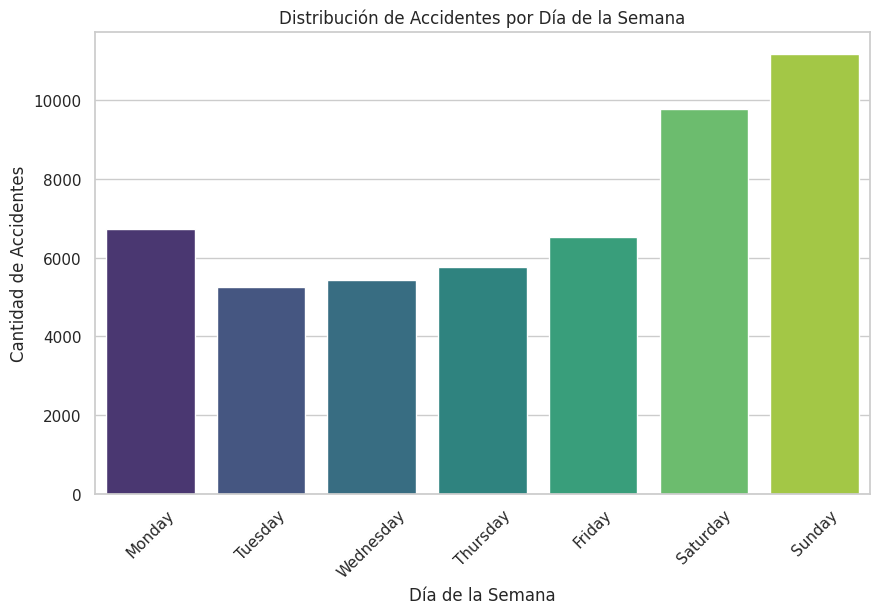

In [219]:
# ----------------------------------------
# 4) Distribución de Accidentes por Día de la Semana
# ----------------------------------------

print("Derivando el Día de la Semana a partir de la fecha del hecho...")

# Aseguramos que 'fecha_hecho' sea tipo datetime
df["fecha_hecho"] = pd.to_datetime(df["fecha_hecho"], dayfirst=True, errors="coerce")

# Creamos la nueva columna con el día de la semana
df["dia_semana"] = df["fecha_hecho"].dt.day_name()

# Filtramos filas con fecha válida
df_dia = df.dropna(subset=["dia_semana"])

print("Distribución de Accidentes por Día de la Semana:")

plt.figure()
sns.countplot(data=df_dia, x="dia_semana", order=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"], palette="viridis")
plt.title("Distribución de Accidentes por Día de la Semana")
plt.xlabel("Día de la Semana")
plt.ylabel("Cantidad de Accidentes")
plt.xticks(rotation=45)
plt.show()


Distribución de Accidentes por Hora del Día:


/tmp/ipython-input-220-412206676.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_hora, x="hora_numerica", palette="Blues")


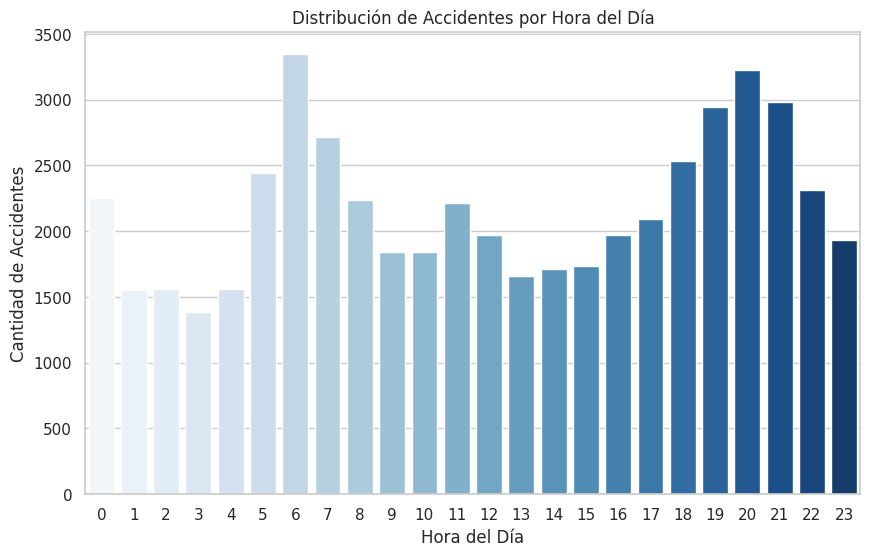

In [220]:
# ----------------------------------------
# 5) Distribución de Accidentes por Hora del Día (Formato Correcto)
# ----------------------------------------

print("Distribución de Accidentes por Hora del Día:")

# Convertimos la hora a datetime usando el formato correcto
df["hora_numerica"] = pd.to_datetime(df["hora_hecho"], format="%H:%M:%S", errors="coerce").dt.hour

# Filtramos solo las filas con hora válida
df_hora = df.dropna(subset=["hora_numerica"])

# Gráfico de barras claro por hora
plt.figure()
sns.countplot(data=df_hora, x="hora_numerica", palette="Blues")
plt.title("Distribución de Accidentes por Hora del Día")
plt.xlabel("Hora del Día")
plt.ylabel("Cantidad de Accidentes")
plt.xticks(np.arange(0, 24, 1))
plt.show()


Creando columna de Grupo Etario para las Víctimas...
Distribución de Accidentes por Grupo Etario de las Víctimas:


/tmp/ipython-input-221-2970498144.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_victimas, x="grupo_etario_victima", order=labels, palette="crest")


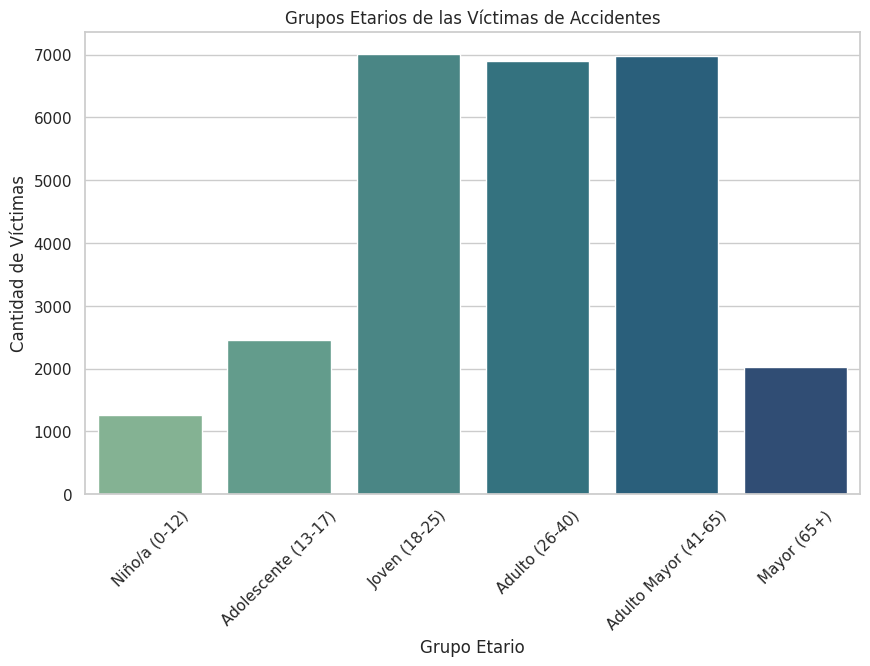

In [221]:
# ----------------------------------------
# 6) Análisis de Grupos Etarios de las Víctimas (Corregido)
# ----------------------------------------

print("Creando columna de Grupo Etario para las Víctimas...")

# Extraemos solo los números de la edad, si existen
df["victima_tr_edad"] = df["victima_tr_edad"].astype(str).str.extract(r'(\d+)')[0]
df["victima_tr_edad"] = pd.to_numeric(df["victima_tr_edad"], errors="coerce")

# Creamos los grupos etarios a partir de la edad
bins = [0, 12, 17, 25, 40, 65, 100]
labels = ["Niño/a (0-12)", "Adolescente (13-17)", "Joven (18-25)", "Adulto (26-40)", "Adulto Mayor (41-65)", "Mayor (65+)"]

df["grupo_etario_victima"] = pd.cut(df["victima_tr_edad"], bins=bins, labels=labels, right=True)

# Filtramos solo las filas con edad válida
df_victimas = df.dropna(subset=["grupo_etario_victima"])

print("Distribución de Accidentes por Grupo Etario de las Víctimas:")

plt.figure()
sns.countplot(data=df_victimas, x="grupo_etario_victima", order=labels, palette="crest")
plt.title("Grupos Etarios de las Víctimas de Accidentes")
plt.xlabel("Grupo Etario")
plt.ylabel("Cantidad de Víctimas")
plt.xticks(rotation=45)
plt.show()


Distribución de Accidentes por Tipo de Vehículo de las Víctimas:


/tmp/ipython-input-222-3557951191.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x="victima_vehiculo", order=df["victima_vehiculo"].value_counts().index, palette="muted")


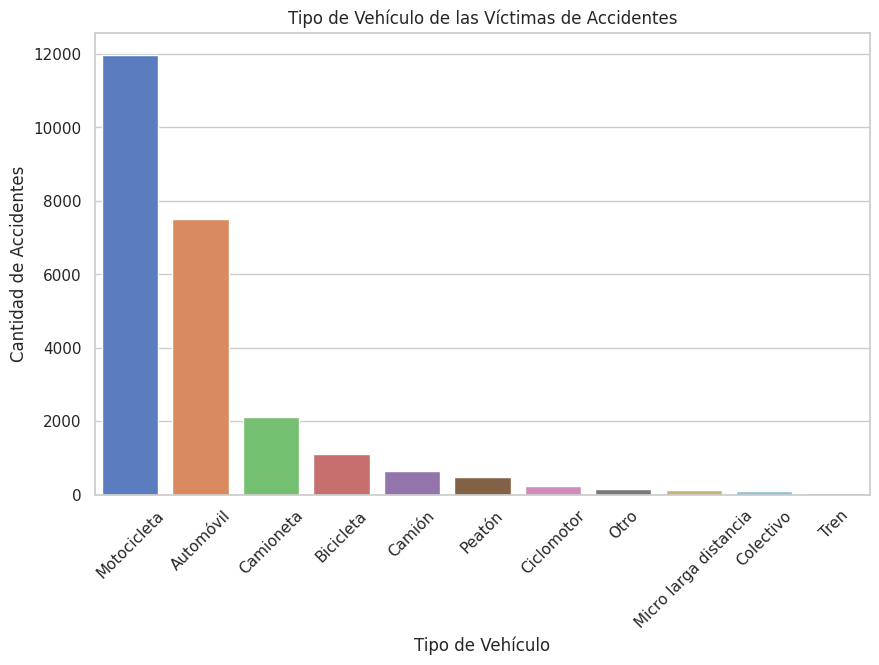

In [222]:
# ----------------------------------------
# 7) Análisis por Tipo de Vehículo de las Víctimas
# ----------------------------------------

print("Distribución de Accidentes por Tipo de Vehículo de las Víctimas:")

plt.figure()
sns.countplot(data=df, x="victima_vehiculo", order=df["victima_vehiculo"].value_counts().index, palette="muted")
plt.title("Tipo de Vehículo de las Víctimas de Accidentes")
plt.xlabel("Tipo de Vehículo")
plt.ylabel("Cantidad de Accidentes")
plt.xticks(rotation=45)
plt.show()

df_victimas_veh = df.dropna(subset=["victima_vehiculo"])



Distribución de Accidentes según el Sexo de las Víctimas:


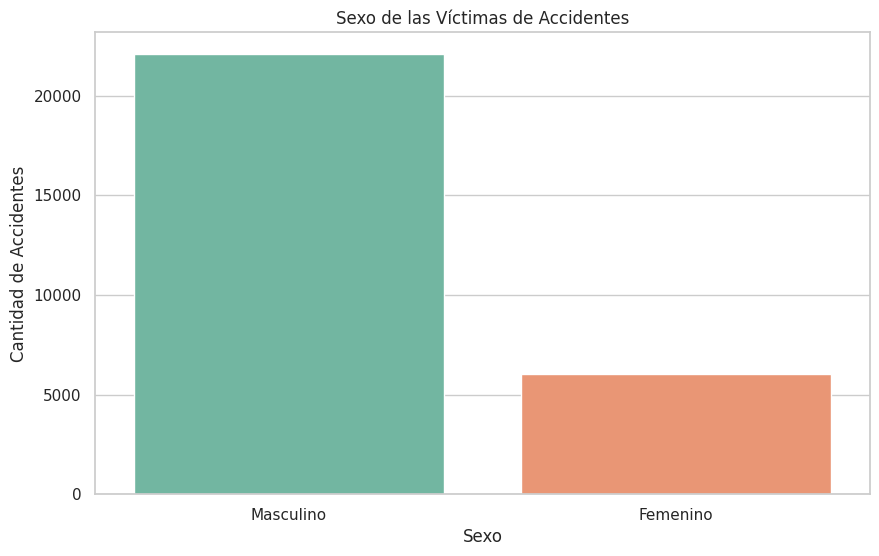

In [223]:
# ----------------------------------------
# 8) Análisis de Sexo de las Víctimas
# ----------------------------------------

print("Distribución de Accidentes según el Sexo de las Víctimas:")

plt.figure()
sns.countplot(data=df, x="victima_sexo", palette="Set2")
plt.title("Sexo de las Víctimas de Accidentes")
plt.xlabel("Sexo")
plt.ylabel("Cantidad de Accidentes")
plt.show()

df_victimas_sexo = df.dropna(subset=["victima_sexo"])


Distribución de Accidentes por Tipo de Vehículo de los Inculpados:


/tmp/ipython-input-224-3609668681.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x="inculpado_vehiculo", order=df["inculpado_vehiculo"].value_counts().index, palette="pastel")


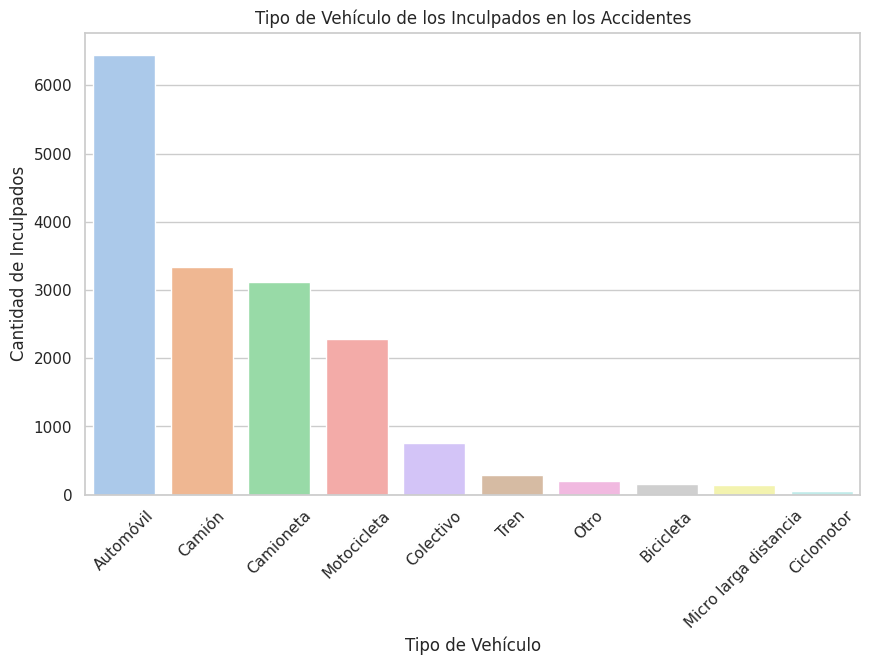

In [224]:
# ----------------------------------------
# 10) Análisis por Tipo de Vehículo de los Inculpados
# ----------------------------------------

print("Distribución de Accidentes por Tipo de Vehículo de los Inculpados:")

plt.figure()
sns.countplot(data=df, x="inculpado_vehiculo", order=df["inculpado_vehiculo"].value_counts().index, palette="pastel")
plt.title("Tipo de Vehículo de los Inculpados en los Accidentes")
plt.xlabel("Tipo de Vehículo")
plt.ylabel("Cantidad de Inculpados")
plt.xticks(rotation=45)
plt.show()

df_inculpados_veh = df.dropna(subset=["inculpado_vehiculo"])



In [225]:
# ----------------------------------------
# 11) Visualización Geográfica de Accidentes
# ----------------------------------------

print("Mapa de Accidentes Georreferenciados:")

# Nos aseguramos que las coordenadas sean numéricas
df["latitud"] = pd.to_numeric(df["latitud"], errors="coerce")
df["longitud"] = pd.to_numeric(df["longitud"], errors="coerce")

# Filtramos las filas con coordenadas válidas
df_mapa = df.dropna(subset=["latitud", "longitud"])

m = folium.Map(location=[-34.61, -58.38], zoom_start=11)
marker_cluster = MarkerCluster().add_to(m)

for _, row in df_mapa.iterrows():
    folium.Marker([row["latitud"], row["longitud"]]).add_to(marker_cluster)

display(m)


Mapa de Accidentes Georreferenciados:


# Mineria de **datos**

In [226]:
# ----------------------------------------
# 12) Clustering Geográfico con KMeans - Corregido
# ----------------------------------------

print("Aplicando Clustering Geográfico (KMeans)...")

# Filtramos solo las filas con latitud y longitud válidas
coords = df[["latitud", "longitud"]].dropna()

print(f"Cantidad de puntos con coordenadas válidas: {coords.shape[0]}")

# Verificamos que haya suficientes puntos
if coords.shape[0] >= 1:
    kmeans = KMeans(n_clusters=5, random_state=0)
    df.loc[coords.index, "cluster"] = kmeans.fit_predict(coords)
    print("Clustering completado. Los accidentes se agruparon en 5 zonas.")
else:
    print("⚠️ No hay suficientes datos geográficos para aplicar KMeans.")

coords = df.dropna(subset=["latitud", "longitud"])[["latitud", "longitud"]]



Aplicando Clustering Geográfico (KMeans)...
Cantidad de puntos con coordenadas válidas: 32337
Clustering completado. Los accidentes se agruparon en 5 zonas.


In [227]:
# ----------------------------------------
# 13) Visualización de Clusters Geográficos
# ----------------------------------------

print("Mapa con los Clusters de Accidentes:")

# Aseguramos que latitud, longitud y cluster sean numéricos por seguridad
df["latitud"] = pd.to_numeric(df["latitud"], errors="coerce")
df["longitud"] = pd.to_numeric(df["longitud"], errors="coerce")
df["cluster"] = pd.to_numeric(df["cluster"], errors="coerce")

# Filtramos las filas con coordenadas y cluster válidos
df_mapa = df.dropna(subset=["latitud", "longitud", "cluster"])

colors = ['red', 'blue', 'green', 'purple', 'orange']
m_clusters = folium.Map(location=[-34.61, -58.38], zoom_start=11)

for _, row in df_mapa.iterrows():
    folium.CircleMarker(
        location=[row["latitud"], row["longitud"]],
        radius=3,
        color=colors[int(row["cluster"])],
        fill=True,
        fill_opacity=0.6
    ).add_to(m_clusters)

display(m_clusters)


Mapa con los Clusters de Accidentes:


In [228]:
# ----------------------------------------
# 14) Exportación del Dataset Sanitizado para Google Looker
# ----------------------------------------

print("Exportando el dataset limpio y listo para Looker...")

# Exportación a archivo CSV sin índice
df.to_csv("dataset_sanitizado_final.csv", index=False)

print("✅ Dataset exportado exitosamente como 'dataset_sanitizado_final.csv'.")
print("Podés descargarlo desde el icono de archivos de la izquierda en Colab.")


Exportando el dataset limpio y listo para Looker...
✅ Dataset exportado exitosamente como 'dataset_sanitizado_final.csv'.
Podés descargarlo desde el icono de archivos de la izquierda en Colab.
